<center>
<img src="https://habrastorage.org/web/677/8e1/337/6778e1337c3d4b159d7e99df94227cb2.jpg"/>
## Специализация "Машинное обучение и анализ данных"
<center>Автор материала: программист-исследователь Mail.Ru Group, старший преподаватель Факультета Компьютерных Наук ВШЭ [Юрий Кашницкий](https://yorko.github.io/)

# <center> Capstone проект №1 <br> Идентификация пользователей по посещенным веб-страницам
<img src='http://i.istockimg.com/file_thumbview_approve/21546327/5/stock-illustration-21546327-identification-de-l-utilisateur.jpg'>

# <center>Неделя 5.  Соревнование Kaggle "Catch Me If You Can"

На этой неделе мы вспомним про концепцию стохастического градиентного спуска и опробуем классификатор Scikit-learn SGDClassifier, который работает намного быстрее на больших выборках, чем алгоритмы, которые мы тестировали на 4 неделе. Также мы познакомимся с данными [соревнования](https://inclass.kaggle.com/c/catch-me-if-you-can-intruder-detection-through-webpage-session-tracking2) Kaggle по идентификации пользователей и сделаем в нем первые посылки. По итогам этой недели дополнительные баллы получат те, кто попадет в топ-30 публичного лидерборда соревнования.

**В этой части проекта Вам могут быть полезны видеозаписи следующих лекций курса "Обучение на размеченных данных":**
   - [Стохатический градиентный спуск](https://www.coursera.org/learn/supervised-learning/lecture/xRY50/stokhastichieskii-ghradiientnyi-spusk)
   - [Линейные модели. Sklearn.linear_model. Классификация](https://www.coursera.org/learn/supervised-learning/lecture/EBg9t/linieinyie-modieli-sklearn-linear-model-klassifikatsiia)
   
**Также рекомендуется вернуться и просмотреть [задание](https://www.coursera.org/learn/supervised-learning/programming/t2Idc/linieinaia-rieghriessiia-i-stokhastichieskii-ghradiientnyi-spusk) "Линейная регрессия и стохастический градиентный спуск" 1 недели 2 курса специализации.**

### Задание
1. Заполните код в этой тетрадке 
2. Если вы проходите специализацию Яндеса и МФТИ, пошлите тетрадку в соответствующем Peer Review. <br> Если вы проходите курс ODS, выберите ответы в [веб-форме](https://docs.google.com/forms/d/1pLsegkAICL9PzOLyAeH9DmDOBfktte0l8JW75uWcTng). 

In [1]:
from __future__ import division, print_function
# отключим всякие предупреждения Anaconda
import warnings
warnings.filterwarnings('ignore')
import os
import pickle
import numpy as np
import pandas as pd
from scipy.sparse import csr_matrix
from sklearn.model_selection import train_test_split
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import roc_auc_score

**Считаем данные [соревнования](https://inclass.kaggle.com/c/catch-me-if-you-can-intruder-detection-through-webpage-session-tracking2) в DataFrame train_df и test_df (обучающая и тестовая выборки).**

In [2]:
# Поменяйте на свой путь к данным
PATH_TO_DATA = 'capstone_user_identification'

In [3]:
train_df = pd.read_csv(os.path.join(PATH_TO_DATA, 'train_sessions.csv'),
                       index_col='session_id')
test_df = pd.read_csv(os.path.join(PATH_TO_DATA, 'test_sessions.csv'),
                      index_col='session_id')

In [4]:
site_dic = pickle.load(open(os.path.join(PATH_TO_DATA, 'site_dic.pkl'),'rb'))

In [5]:
len(site_dic)

48371

In [93]:
train_df.shape, test_df.shape

((253561, 21), (82797, 20))

In [94]:
train_df.head()

,site1,time1,site2,time2,site3,time3,site4,time4,site5,time5,...,time6,site7,time7,site8,time8,site9,time9,site10,time10,target
session_id,,,,,,,,,,,,,,,,,,,,,
1,718,2014-02-20 10:02:45,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaT,...,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaT,0
2,890,2014-02-22 11:19:50,941.0,2014-02-22 11:19:50,3847.0,2014-02-22 11:19:51,941.0,2014-02-22 11:19:51,942.0,2014-02-22 11:19:51,...,2014-02-22 11:19:51,3847.0,2014-02-22 11:19:52,3846.0,2014-02-22 11:19:52,1516.0,2014-02-22 11:20:15,1518.0,2014-02-22 11:20:16,0
3,14769,2013-12-16 16:40:17,39.0,2013-12-16 16:40:18,14768.0,2013-12-16 16:40:19,14769.0,2013-12-16 16:40:19,37.0,2013-12-16 16:40:19,...,2013-12-16 16:40:19,14768.0,2013-12-16 16:40:20,14768.0,2013-12-16 16:40:21,14768.0,2013-12-16 16:40:22,14768.0,2013-12-16 16:40:24,0
4,782,2014-03-28 10:52:12,782.0,2014-03-28 10:52:42,782.0,2014-03-28 10:53:12,782.0,2014-03-28 10:53:42,782.0,2014-03-28 10:54:12,...,2014-03-28 10:54:42,782.0,2014-03-28 10:55:12,782.0,2014-03-28 10:55:42,782.0,2014-03-28 10:56:12,782.0,2014-03-28 10:56:42,0
5,22,2014-02-28 10:53:05,177.0,2014-02-28 10:55:22,175.0,2014-02-28 10:55:22,178.0,2014-02-28 10:55:23,177.0,2014-02-28 10:55:23,...,2014-02-28 10:55:59,175.0,2014-02-28 10:55:59,177.0,2014-02-28 10:55:59,177.0,2014-02-28 10:57:06,178.0,2014-02-28 10:57:11,0


**Объединим обучающую и тестовую выборки – это понадобится, чтоб вместе потом привести их к разреженному формату.**

In [95]:
train_test_df = pd.concat([train_df, test_df])

В обучающей выборке видим следующие признаки:
    - site1 – индекс первого посещенного сайта в сессии
    - time1 – время посещения первого сайта в сессии
    - ...
    - site10 – индекс 10-го посещенного сайта в сессии
    - time10 – время посещения 10-го сайта в сессии
    - user_id – ID пользователя
    
Сессии пользователей выделены таким образом, что они не могут быть длинее получаса или 10 сайтов. То есть сессия считается оконченной либо когда пользователь посетил 10 сайтов подряд, либо когда сессия заняла по времени более 30 минут. 

**Посмотрим на статистику признаков.**

Пропуски возникают там, где сессии короткие (менее 10 сайтов). Скажем, если человек 1 января 2015 года посетил *vk.com* в 20:01, потом *yandex.ru* в 20:29, затем *google.com* в 20:33, то первая его сессия будет состоять только из двух сайтов (site1 – ID сайта *vk.com*, time1 – 2015-01-01 20:01:00, site2 – ID сайта  *yandex.ru*, time2 – 2015-01-01 20:29:00, остальные признаки – NaN), а начиная с *google.com* пойдет новая сессия, потому что уже прошло более 30 минут с момента посещения *vk.com*.

In [8]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 253561 entries, 1 to 253561
Data columns (total 21 columns):
site1     253561 non-null int64
time1     253561 non-null object
site2     250098 non-null float64
time2     250098 non-null object
site3     246919 non-null float64
time3     246919 non-null object
site4     244321 non-null float64
time4     244321 non-null object
site5     241829 non-null float64
time5     241829 non-null object
site6     239495 non-null float64
time6     239495 non-null object
site7     237297 non-null float64
time7     237297 non-null object
site8     235224 non-null float64
time8     235224 non-null object
site9     233084 non-null float64
time9     233084 non-null object
site10    231052 non-null float64
time10    231052 non-null object
target    253561 non-null int64
dtypes: float64(9), int64(2), object(10)
memory usage: 42.6+ MB


In [9]:
test_df.head()

,site1,time1,site2,time2,site3,time3,site4,time4,site5,time5,site6,time6,site7,time7,site8,time8,site9,time9,site10,time10
session_id,,,,,,,,,,,,,,,,,,,,
1,29,2014-10-04 11:19:53,35.0,2014-10-04 11:19:53,22.0,2014-10-04 11:19:54,321.0,2014-10-04 11:19:54,23.0,2014-10-04 11:19:54,2211.0,2014-10-04 11:19:54,6730.0,2014-10-04 11:19:54,21.0,2014-10-04 11:19:54,44582.0,2014-10-04 11:20:00,15336.0,2014-10-04 11:20:00
2,782,2014-07-03 11:00:28,782.0,2014-07-03 11:00:53,782.0,2014-07-03 11:00:58,782.0,2014-07-03 11:01:06,782.0,2014-07-03 11:01:09,782.0,2014-07-03 11:01:10,782.0,2014-07-03 11:01:23,782.0,2014-07-03 11:01:29,782.0,2014-07-03 11:01:30,782.0,2014-07-03 11:01:53
3,55,2014-12-05 15:55:12,55.0,2014-12-05 15:55:13,55.0,2014-12-05 15:55:14,55.0,2014-12-05 15:56:15,55.0,2014-12-05 15:56:16,55.0,2014-12-05 15:56:17,55.0,2014-12-05 15:56:18,55.0,2014-12-05 15:56:19,1445.0,2014-12-05 15:56:33,1445.0,2014-12-05 15:56:36
4,1023,2014-11-04 10:03:19,1022.0,2014-11-04 10:03:19,50.0,2014-11-04 10:03:20,222.0,2014-11-04 10:03:21,202.0,2014-11-04 10:03:21,3374.0,2014-11-04 10:03:22,50.0,2014-11-04 10:03:22,48.0,2014-11-04 10:03:22,48.0,2014-11-04 10:03:23,3374.0,2014-11-04 10:03:23
5,301,2014-05-16 15:05:31,301.0,2014-05-16 15:05:32,301.0,2014-05-16 15:05:33,66.0,2014-05-16 15:05:39,67.0,2014-05-16 15:05:40,69.0,2014-05-16 15:05:40,70.0,2014-05-16 15:05:40,68.0,2014-05-16 15:05:40,71.0,2014-05-16 15:05:40,167.0,2014-05-16 15:05:44


In [10]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 82797 entries, 1 to 82797
Data columns (total 20 columns):
site1     82797 non-null int64
time1     82797 non-null object
site2     81308 non-null float64
time2     81308 non-null object
site3     80075 non-null float64
time3     80075 non-null object
site4     79182 non-null float64
time4     79182 non-null object
site5     78341 non-null float64
time5     78341 non-null object
site6     77566 non-null float64
time6     77566 non-null object
site7     76840 non-null float64
time7     76840 non-null object
site8     76151 non-null float64
time8     76151 non-null object
site9     75484 non-null float64
time9     75484 non-null object
site10    74806 non-null float64
time10    74806 non-null object
dtypes: float64(9), int64(1), object(10)
memory usage: 13.3+ MB


**В обучающей выборке – 2297 сессий одного пользователя (Alice) и 251264 сессий – других пользователей, не Элис. Дисбаланс классов очень сильный, и смотреть на долю верных ответов (accuracy) непоказательно.**

In [11]:
train_df['target'].value_counts()

0    251264
1      2297
Name: target, dtype: int64

**Пока для прогноза будем использовать только индексы посещенных сайтов. Индексы нумеровались с 1, так что заменим пропуски на нули.**

In [12]:
train_test_df_sites = train_test_df[['site%d' % i for i in range(1, 11)]].fillna(0).astype('int')

In [13]:
train_test_df_sites.head(10)

,site1,site2,site3,site4,site5,site6,site7,site8,site9,site10
session_id,,,,,,,,,,
1,718,0,0,0,0,0,0,0,0,0
2,890,941,3847,941,942,3846,3847,3846,1516,1518
3,14769,39,14768,14769,37,39,14768,14768,14768,14768
4,782,782,782,782,782,782,782,782,782,782
5,22,177,175,178,177,178,175,177,177,178
6,570,21,570,21,21,0,0,0,0,0
7,803,23,5956,17513,37,21,803,17514,17514,17514
8,22,21,29,5041,14422,23,21,5041,14421,14421
9,668,940,942,941,941,942,940,23,21,22


**Создайте разреженные матрицы *X_train_sparse* и *X_test_sparse* аналогично тому, как мы это делали ранее. Используйте объединенную матрицу *train_test_df_sites*, потом разделите обратно на обучающую и тестовую части.**

Обратите внимание на то, что в  сессиях меньше 10 сайтов  у нас остались нули, так что первый признак (сколько раз попался 0) по смыслу отличен от остальных (сколько раз попался сайт с индексом $i$). Поэтому первый столбец разреженной матрицы надо будет удалить.

**Выделите в отдельный вектор *y* ответы на обучающей выборке.**

In [14]:
def get_sparse(docs):
    indptr = [0]
    indices = []
    data = []
    vocabulary = {}
    for d in docs:
        for term in d:
#             if term == 0: continue
            index = vocabulary.setdefault(term, term)
            indices.append(index)
            data.append(1)

        indptr.append(len(indices))
#     print(indices)
    return csr_matrix((data, indices, indptr), dtype=int)[:,1:]

In [15]:
%%time
train_test_sparse = get_sparse(train_test_df_sites.values)
X_train_sparse = train_test_sparse[:train_df.shape[0]]
X_test_sparse = train_test_sparse[train_df.shape[0]:]
y = train_df.target

CPU times: user 2.35 s, sys: 42.2 ms, total: 2.39 s
Wall time: 2.4 s


**<font color='red'>Вопрос 1. </font> Выведите размерности матриц *X_train_sparse* и *X_test_sparse* – 4 числа на одной строке через пробел: число строк и столбцов матрицы *X_train_sparse*, затем число строк и столбцов матрицы *X_test_sparse*.**

In [16]:
print(' '.join(map(str, X_train_sparse.shape)),
      ' '.join(map(str, X_test_sparse.shape))
     )

253561 48371 82797 48371


**Сохраним в pickle-файлы объекты *X_train_sparse*, *X_test_sparse* и *y* (последний – в файл *kaggle_data/train_target.pkl*).**

In [17]:
with open(os.path.join(PATH_TO_DATA, 'X_train_sparse.pkl'), 'wb') as X_train_sparse_pkl:
    pickle.dump(X_train_sparse, X_train_sparse_pkl, protocol=2)
with open(os.path.join(PATH_TO_DATA, 'X_test_sparse.pkl'), 'wb') as X_test_sparse_pkl:
    pickle.dump(X_test_sparse, X_test_sparse_pkl, protocol=2)
with open(os.path.join(PATH_TO_DATA, 'train_target.pkl'), 'wb') as train_target_pkl:
    pickle.dump(y, train_target_pkl, protocol=2)

**Разобьем обучающую выборку на 2 части в пропорции 7/3, причем не перемешивая. Исходные данные упорядочены по времени, тестовая выборка по времени четко отделена от обучающей, это же соблюдем и здесь.**

In [18]:
train_share = int(.7 * X_train_sparse.shape[0])
X_train, y_train = X_train_sparse[:train_share, :], y[:train_share]
X_valid, y_valid  = X_train_sparse[train_share:, :], y[train_share:]

**Создайте объект `sklearn.linear_model.SGDClassifier` с логистической функцией потерь и параметром *random_state*=17. Остальные параметры оставьте по умолчанию, разве что *n_jobs*=-1 никогда не помешает. Обучите  модель на выборке `(X_train, y_train)`.**

In [19]:
X_train

<177492x48371 sparse matrix of type '<class 'numpy.int64'>'
	with 1688867 stored elements in Compressed Sparse Row format>

In [20]:
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import roc_auc_score

In [21]:
sgd_logit = SGDClassifier(loss='log', random_state=17, n_jobs=-1)
sgd_logit.fit(X_train, y_train)

SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.0, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='log', max_iter=1000,
              n_iter_no_change=5, n_jobs=-1, penalty='l2', power_t=0.5,
              random_state=17, shuffle=True, tol=0.001, validation_fraction=0.1,
              verbose=0, warm_start=False)

**Сделайте прогноз в виде предсказанных вероятностей того, что это сессия Элис, на отложенной выборке *(X_valid, y_valid)*.**

In [22]:
logit_valid_pred_proba = sgd_logit.predict_proba(X_valid)
logit_valid_pred_proba

array([[9.11911413e-01, 8.80885865e-02],
       [9.99703507e-01, 2.96493343e-04],
       [9.99872654e-01, 1.27345522e-04],
       ...,
       [9.87751880e-01, 1.22481202e-02],
       [9.99943934e-01, 5.60663172e-05],
       [9.88685254e-01, 1.13147460e-02]])

**<font color='red'>Вопрос 2. </font> Посчитайте ROC AUC логистической регрессии, обученной с помощью стохастического градиентного спуска, на отложенной выборке. Округлите до 3 знаков после разделителя.**

In [23]:
round(roc_auc_score(y_valid, logit_valid_pred_proba[:,1]), 3)

0.934

**Сделайте прогноз в виде предсказанных вероятностей отнесения к классу 1 для тестовой выборки с помощью той же *sgd_logit*, обученной уже на всей обучающей выборке (а не на 70%).**

In [24]:
%%time
sgd_logit.fit(X_train_sparse, y)
logit_test_pred_proba = sgd_logit.predict_proba(X_test_sparse)

CPU times: user 828 ms, sys: 247 ms, total: 1.07 s
Wall time: 748 ms


**Запишите ответы в файл и сделайте посылку на Kaggle. Дайте своей команде (из одного человека) на Kaggle говорящее название – по шаблону "[YDF & MIPT] Coursera_Username", чтоб можно было легко идентифицировать Вашу посылку на [лидерборде](https://inclass.kaggle.com/c/catch-me-if-you-can-intruder-detection-through-webpage-session-tracking2/leaderboard/public).**

**Результат, который мы только что получили, соответствует бейзлайну "SGDCLassifer" на лидерборде, задача на эту неделю – как минимум его побить.**

In [25]:
def write_to_submission_file(predicted_labels, out_file,
                             target='target', index_label="session_id"):
    # turn predictions into data frame and save as csv file
    predicted_df = pd.DataFrame(predicted_labels,
                                index = np.arange(1, predicted_labels.shape[0] + 1),
                                columns=[target])
    predicted_df.to_csv(out_file, index_label=index_label)

In [26]:
write_to_submission_file(logit_test_pred_proba[:,1], 'submit1.csv')

# Самостоятельная часть
## Create new features

Public leaderboard = 0.91646

In [27]:
features_sites = [f for f in train_df.columns if 'site' in f]
features_time = [f for f in train_df.columns if 'time' in f]
for f in features_time:
    train_test_df[f] = pd.to_datetime(train_test_df[f])
    train_df[f] = pd.to_datetime(train_df[f])
    test_df[f] = pd.to_datetime(test_df[f])

In [28]:
# create initial adding features
def create_initial_new_features(data, test=False):
    train_df = data.copy()
    train_df['nunique_sites'] = train_df[features_sites].nunique(axis=1)
    train_df['first_time'] = train_df[features_time].min(axis=1)
    train_df['start_hour'] = train_df['first_time'].dt.hour
    train_df['day_of_week'] = train_df['first_time'].dt.dayofweek
    to_drop = features_time+['first_time'] if test else features_time+['target','first_time']
    return train_df, train_df.drop(columns=to_drop).columns.tolist()

In [110]:
import IPython

def display(*dfs):
    for df in dfs:
        IPython.display.display(df)

In [168]:
def transform_ini_features(data):
    train_df = data.copy()
    train_df.reset_index(inplace=True, drop=True)
    train_df['part_day'] = pd.cut(x=train_df.start_hour, bins=[0,5,11,18,24],
                              include_lowest=True, labels=[0,1,2,3]).astype('int')
    temp = pd.get_dummies(train_df.part_day, prefix='part_day')
    train_df = train_df.merge(temp, left_index=True, right_index=True)
    train_df.part_day = 0
    
    temp = pd.get_dummies(train_df.day_of_week, prefix='day_of_week')
    train_df = train_df.merge(temp, left_index=True, right_index=True)
    
    return train_df

In [30]:
train_df2, features2 = create_initial_new_features(train_test_df)
assert train_df2.shape[0] == train_test_df.shape[0]

In [170]:
train_df3 = transform_ini_features(train_df2)
assert train_df3.shape[0] == train_test_df.shape[0]

In [172]:
# train_df3.drop(features_time+['target','first_time'], axis=1, inplace=True)
train = train_df3.iloc[:train_df.shape[0]]
test = train_df3.iloc[train_df.shape[0]:]
train.columns.tolist()

['site1',
 'site10',
 'site2',
 'site3',
 'site4',
 'site5',
 'site6',
 'site7',
 'site8',
 'site9',
 'target',
 'time1',
 'time10',
 'time2',
 'time3',
 'time4',
 'time5',
 'time6',
 'time7',
 'time8',
 'time9',
 'nunique_sites',
 'first_time',
 'start_hour',
 'day_of_week',
 'part_day',
 'part_day_1',
 'part_day_2',
 'part_day_3',
 'day_of_week_0',
 'day_of_week_1',
 'day_of_week_2',
 'day_of_week_3',
 'day_of_week_4',
 'day_of_week_5',
 'day_of_week_6']

In [173]:
import scipy
def get_all_features(features, train_df, test_df):
    X_train_sparse_2 = hstack((X_train_sparse, train_df[features].values))
    X_test_sparse_2 = hstack((X_test_sparse, test_df[features].values))
    
    return X_train_sparse_2, X_test_sparse_2

In [181]:
%%time
features_drop = features_sites + features_time + \
                ['target','nunique_sites',
                 'first_time', 'start_hour', 
                 'day_of_week']
features = train.drop(columns=features_drop).columns
X, X_test = get_all_features(features, train, test)
assert X_test_sparse.shape[0] == test.shape[0]

CPU times: user 114 ms, sys: 6.71 ms, total: 121 ms
Wall time: 122 ms


In [183]:
from sklearn.model_selection import cross_validate
from sklearn.model_selection import TimeSeriesSplit

time_split = TimeSeriesSplit(n_splits=3)

sgd_logit = SGDClassifier(loss='log', random_state=17, n_jobs=-1)
cv = cross_validate(sgd_logit, X, y, cv=time_split, scoring='roc_auc', 
                     n_jobs=-1, return_train_score=True)

cv['test_score'].mean(), cv['train_score'].mean()

(0.9683302747322946, 0.9774898298308871)

In [180]:
sgd_logit.fit(X, y)
write_to_submission_file(sgd_logit.predict_proba(X_test)[:,1],
                         'submit2.scv')

Public score = 0.94074 better than initial 0.91646

CPU times: user 135 ms, sys: 71 ms, total: 206 ms
Wall time: 941 ms


(0.9682023246240602, 0.9773917575095297)

In [192]:
def create_new_features(data, alice_top10, test=False):
    train_df = data.copy()

    train_df['sites_length'] = train_df[features_sites].notna().sum(axis=1)
    train_df['nunique_sites_pre_session'] = train_df.nunique_sites/train_df.sites_length    
    
    timespam_df = train_df[features_time].diff(axis=1)
    timespam_df[timespam_df > pd.Timedelta(90000, unit='days')] = 0
    timespam_df['sites_length'] = train_df.sites_length
    gr = timespam_df.groupby('sites_length')
    to_add = gr.apply(lambda x, axis:  x.iloc[:, 1:x.sites_length.iloc[0]]\
                               .mean(axis=1), axis=1)
    to_add.index = to_add.index.droplevel(0)
    to_add.name = 'timespan_mean'
    train_df = train_df.merge(to_add, left_index=True, right_index=True, how='left')
    
    train_df['n_in_alice_top10'] = train_df[features_sites].isin(alice_top10).sum(axis=1)
    
    to_drop = features_time+['first_time'] if test else features_time+['target','first_time']
    return train_df, train_df.drop(columns=to_drop).columns.tolist()

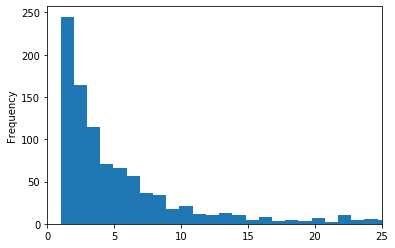

In [188]:
alice_top = train_df[train_df.target==1]
alice_top = alice_top[features_sites].melt()['value'].value_counts()
alice_top.plot(kind='hist', bins=1400,  xlim=(0,25))

alice_top10 = alice_top.iloc[:10].index.tolist()

In [194]:
train_df4, features4 = create_new_features(train_df3, alice_top10)
assert train_df4.shape[0] == train_df3.shape[0]

In [197]:
train_df4.columns.tolist()

['site1',
 'site10',
 'site2',
 'site3',
 'site4',
 'site5',
 'site6',
 'site7',
 'site8',
 'site9',
 'target',
 'time1',
 'time10',
 'time2',
 'time3',
 'time4',
 'time5',
 'time6',
 'time7',
 'time8',
 'time9',
 'nunique_sites',
 'first_time',
 'start_hour',
 'day_of_week',
 'part_day',
 'part_day_1',
 'part_day_2',
 'part_day_3',
 'day_of_week_0',
 'day_of_week_1',
 'day_of_week_2',
 'day_of_week_3',
 'day_of_week_4',
 'day_of_week_5',
 'day_of_week_6',
 'sites_length',
 'nunique_sites_pre_session',
 'timespan_mean',
 'n_in_alice_top10']

In [219]:
%%time
train = train_df4.iloc[:train_df.shape[0]]
test = train_df4.iloc[train_df.shape[0]:]

features_drop = features_sites + features_time + \
                ['target', #'nunique_sites',
                 'first_time', 'start_hour', 'day_of_week',
#                 'part_day', 'day_of_week_0']
                ]
features = train.drop(columns=features_drop).columns
train[features] = train[features].fillna(0)
test[features] = test[features].fillna(0)

from sklearn.preprocessing import StandardScaler

f = ['timespan_mean']
st_sc = StandardScaler()
st_sc.fit(train_df4[f])
train[f] = st_sc.transform(train[f])
test[f] = st_sc.transform(test[f])

X, X_test = get_all_features(features, train, test)
assert X_test_sparse.shape[0] == test.shape[0]

sgd_logit = SGDClassifier(loss='log', random_state=17, n_jobs=-1,
                         penalty='l1')
cv = cross_validate(sgd_logit, X, y, cv=time_split, scoring='roc_auc', 
                     n_jobs=-1, return_train_score=True)

cv['test_score'].mean(), cv['train_score'].mean()

CPU times: user 273 ms, sys: 45.4 ms, total: 319 ms
Wall time: 1.63 s


(0.9516510201200298, 0.9531293159216471)

In [220]:
sgd_logit.fit(X, y)
pd.Series(sgd_logit.coef_[0][-features.shape[0]:], index=features)

nunique_sites                 3.059828
part_day                      0.000000
part_day_1                  -34.430103
part_day_2                    5.760097
part_day_3                   -8.150612
day_of_week_0                 0.993607
day_of_week_1                 0.000000
day_of_week_2               -32.729670
day_of_week_3                 0.000000
day_of_week_4                 0.000000
day_of_week_5                -2.943664
day_of_week_6                -2.115946
sites_length                 -1.058824
nunique_sites_pre_session   -28.200083
timespan_mean                -0.194789
n_in_alice_top10              0.295527
dtype: float64

In [249]:
%%time
train = train_df4.iloc[:train_df.shape[0]]
test = train_df4.iloc[train_df.shape[0]:]

features_drop = features_sites + features_time + \
                ['target', #'nunique_sites',
                 'first_time', 'start_hour', 'day_of_week',
                'part_day', 
                 'day_of_week_1', 'day_of_week_3', 'day_of_week_4']
features = train.drop(columns=features_drop).columns
train[features] = train[features].fillna(0)
test[features] = test[features].fillna(0)

from sklearn.preprocessing import StandardScaler

f = ['timespan_mean']
st_sc = StandardScaler()
st_sc.fit(train_df4[f])
train[f] = st_sc.transform(train[f])
test[f] = st_sc.transform(test[f])

X, X_test = get_all_features(features, train, test)
assert X_test_sparse.shape[0] == test.shape[0]

sgd_logit = SGDClassifier(loss='log', random_state=17, n_jobs=-1,
                         penalty='l2')
cv = cross_validate(sgd_logit, X, y, cv=time_split, scoring='roc_auc', 
                     n_jobs=-1, return_train_score=True)

cv['test_score'].mean(), cv['train_score'].mean()

CPU times: user 310 ms, sys: 234 ms, total: 544 ms
Wall time: 2.48 s


(0.9673377163559088, 0.9779651040231939)

In [250]:
sgd_logit.fit(X, y)
pd.Series(sgd_logit.coef_[0][-features.shape[0]:], index=features)

nunique_sites                0.504673
part_day_1                  -2.821208
part_day_2                   0.010914
part_day_3                  -1.157553
day_of_week_0                0.944116
day_of_week_2               -1.888622
day_of_week_5               -0.508488
day_of_week_6               -1.044247
sites_length                -0.565974
nunique_sites_pre_session   -3.077363
timespan_mean               -0.301790
n_in_alice_top10             0.288302
dtype: float64

In [251]:
features_num = []
for f in features:
    if train[f].nunique() > 2:
        features_num.append(f)
features_num

['nunique_sites',
 'sites_length',
 'nunique_sites_pre_session',
 'timespan_mean',
 'n_in_alice_top10']

In [252]:
import cufflinks as cf
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

import plotly.graph_objects as go

from plotly.subplots import make_subplots

def plot_features_hist(features, df, drop_val=None):
    n = len(features)    
    fig = make_subplots(rows=int(np.ceil(n/4)), cols=4,
                       subplot_titles=features)
    for i, f in enumerate(features):
        row, col = i//4+1, i%4+1
        fig.add_trace(go.Histogram(x=df.loc[df[f]!=drop_val, f], name=f), 
                      row=row, col=col)
    fig.update_layout(height=(2*np.ceil(n/4)+1)*100, showlegend=False,
                      title='Distributions for log features similar to normal')
    fig.update_traces(marker=dict(color='#636EFA'))
    fig.show()

In [253]:
plot_features_hist(features_num, train)

In [254]:
plot_features_hist(features_num, test)

In [255]:
train2, test2 = train.copy(), test.copy()
train2['sites_length'] = np.where(train.sites_length == 10, 1, 0)
test2['sites_length'] = np.where(test.sites_length == 10, 1, 0)

In [256]:
%%time
features_drop = features_sites + features_time + \
                ['target', 'nunique_sites',
                 'first_time', 'start_hour', 'day_of_week',
                'part_day', 
                 'day_of_week_1', 'day_of_week_3', 'day_of_week_4',
                'sites_length', 'nunique_sites_pre_session']
features = train.drop(columns=features_drop).columns
# features = pd.Index(['part_day_1', 'part_day_2', 'part_day_3', 
#             'day_of_week_0', 'day_of_week_2',
#             'day_of_week_5','day_of_week_6'])
train[features] = train[features].fillna(0)
test[features] = test[features].fillna(0)

from sklearn.preprocessing import StandardScaler

f = ['timespan_mean']
st_sc = StandardScaler()
st_sc.fit(train2[f])
train2[f] = st_sc.transform(train2[f])
test2[f] = st_sc.transform(test2[f])

X, X_test = get_all_features(features, train2, test2)
assert X_test_sparse.shape[0] == test.shape[0]

sgd_logit = SGDClassifier(loss='log', random_state=17, n_jobs=-1,
                         penalty='l2')
cv = cross_validate(sgd_logit, X, y, cv=time_split, scoring='roc_auc', 
                     n_jobs=-1, return_train_score=True)

print(cv['test_score'].mean(), cv['train_score'].mean())

sgd_logit.fit(X, y)
pd.Series(sgd_logit.coef_[0][-features.shape[0]:], index=features)

0.9695966946041478 0.9785330876192561
CPU times: user 1.05 s, sys: 242 ms, total: 1.3 s
Wall time: 2.29 s


part_day_1         -4.801622
part_day_2         -2.314538
part_day_3         -2.565765
day_of_week_0       0.801061
day_of_week_2      -1.950952
day_of_week_5      -0.667614
day_of_week_6      -1.110146
timespan_mean      -0.166011
n_in_alice_top10    0.234542
dtype: float64

In [257]:
from sklearn.model_selection import GridSearchCV

In [258]:
a_values = np.logspace(-6, 1, 20)

logit_grid_searcher = GridSearchCV(estimator=sgd_logit, 
                                   param_grid={'alpha': a_values},
                                  scoring='roc_auc', n_jobs=1, 
                                   cv=time_split, verbose=1)
logit_grid_searcher.fit(X, y) 
logit_grid_searcher.best_score_, logit_grid_searcher.best_params_

Fitting 3 folds for each of 20 candidates, totalling 60 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  60 out of  60 | elapsed:   35.2s finished


(0.9739305131360805, {'alpha': 2.9763514416313192e-05})

In [259]:
sgd_logit.alpha = 2.9763514416313192e-05
sgd_logit.fit(X, y)
write_to_submission_file(sgd_logit.predict_proba(X_test)[:,1], 
                        'submit3.csv')

## Критерии оценки работы (только для Peer Review в специализации):
- Правильные ли получились размерности матриц в п. 1? (max. 2 балла)
- Правильным ли получилось значения ROC AUC в п. 2? (max. 4 балла)
- Побит ли бенчмарк "sgd_logit_benchmark.csv" на публичной части рейтинга в соревновании Kaggle? (max. 2 балла)
- Побит ли бенчмарк "Logit +3 features" на публичной части рейтинга в соревновании Kaggle? (max. 2 балла)

## Пути улучшения
На этой неделе дается много времени на соревнование. Не забывайте вносить хорошие идеи, к которым Вы пришли по ходу соревнования, в описание финального проекта (`html`, `pdf` или `ipynb`). Это только в случае, если вы проходите специализацию.
Что можно попробовать:
 - Использовать ранее построенные признаки для улучшения модели (проверить их можно на меньшей выборке по 150 пользователям, отделив одного из пользователей от остальных – это быстрее)
 - Настроить параметры моделей (например, коэффициенты регуляризации)
 - Если позволяют мощности (или хватает терпения), можно попробовать смешивание (блендинг) ответов бустинга и линейной модели. [Вот](http://mlwave.com/kaggle-ensembling-guide/) один из самых известных тьюториалов по смешиванию ответов алгоритмов, также хороша [статья](https://alexanderdyakonov.wordpress.com/2017/03/10/cтекинг-stacking-и-блендинг-blending) Александра Дьяконова
 - Обратите внимание, что в соревновании также даны исходные данные о посещенных веб-страницах Элис и остальными 1557 пользователями (*train.zip*). По этим данным можно сформировать свою обучающую выборку. 

На 6 неделе мы пройдем большой тьюториал по Vowpal Wabbit и попробуем его в деле, на данных соревнования.